# Universidad de Monterrey
## División de Ingenierías
### Lab - Robotics
#### Lab 10: Camera calibration and image distortion correction

Authors: Jesús Ramírez, Kassandra Ibarra, Alberto Herrera

#### Introducción

En la actualidad existen una amplia variedad de modelos y tipos de cámaras, es por esta razón por la que no se puede suponer que una cámara va a mostrar imagenes 100% proporcionales a como lo vería el ojo humano. A estas variaciones se les llama distorsiones y las más comunes son las radiales y tangenciales, una vez que nos enfrentamos al reto de trabajar con una cámara que cuenta con algún tipo de distorsión se puede compensar esta distorsión mediante el uso de librerías y métodos que explicaremos a continuación.

#### Objetivo 

Los objetivos de aprendizaje de este laboratorio se centran en la calibración de la cámara y la corrección de la distorsión de la imagen. La calibración de la cámara se refiere al proceso de estimación de los parámetros intrínsecos y las distorsiones radiales y tangenciales.

#### Materiales 

* Raspberry PI 3
* Pantalla y cable HDMI para visualizar la raspberry.
* Tablero de ajedrez
* Además, la Raspberry debe contar con el software pedido al inicio del laboratorio (opencv, python 3.5, Jupyter, ssh, entre otros).

#### Procedimiento 

Para poder corregir las distorsiones de una cámara se pueden utilizar muchas herramientas, en nuestro caso decidimos utilizar el tablero de ajedrez para calibrar la cámara. Afortunadamente en la librería OpenCV existe un módulo especializado en la calibración de cámaras y que también permite la reconstrucción 3D por lo que se le pueden dar muchas aplicación.

##### cv2.findChessboardCorners

La instrucción principal usada en nuestro código es la función: 

In [ ]:
cv2.findChessboardCorners(gray,patternsize,corners)

Esta función recibe una imagen del tablero, encuentra sus esquinas interiores y devuelve las coordenadas en un vector. La imagen debe estar en escala de grises por esta razón en nuestro código se puede ver que pasamos de BGR a GREYSCALE antes de utilizar esta función. Además de esto, hay que indicarle la cantidad de filas y columnas de nuestro tablero, pero no de los casillas, sino de las esquinas interiores en nuestro caso queda con los parámetros siguientes:

In [ ]:
ret, corners = cv2.findChessboardCorners(gray, (8,6),None)

Esta función devuelve true si encuentra el patrón en la imagen, false en caso contrario.

##### cv2.drawChessboardCorners

Una vez que ya identificamos y encontramos las esquinas interiores de nuestro tablero de ajedrez dentro de una imagen utilizamos la función:

In [ ]:
cv2.drawChessboardCorners(color,patternsize,corners,found)

Aunque esta función no es indispensable para calibrar nuestra cámara, es de mucha ayuda para poder visualizar el funcionamiento de la instrucción anterior que detectó nuestras esquinas interiores por lo que nos permite elegir entre todas las imágenes para saber cuales son útiles y cuáles no. El uso de ambas funciones se muestran en nuestro código siguiente:


In [ ]:
# -*- coding: utf-8 -*-
"""
Created on Sun May  6 20:48:47 2018
@author: Alberto Herrera, Jesús Ramírez y Kassandra Ibarra
"""

import numpy as np
import cv2
import glob

def GetPoints(images):
    # termination criteria
    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)

    # prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
    objp = np.zeros((6*8,3), np.float32)
    objp[:,:2] = np.mgrid[0:8,0:6].T.reshape(-1,2)

    # Arrays to store object points and image points from all the images.
    objpoints = [] # 3d point in real world space
    imgpoints = [] # 2d points in image plane.
    i = 0
    j = 0
    for fname in images:
        img = cv2.imread(fname)
        img = cv2.resize(img, None, fx=0.6, fy=0.6)
        gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
        i=i+1
        print(fname)
        # Find the chess board corners
        ret, corners = cv2.findChessboardCorners(gray, (8,6),None)
        
        # If found, add object points, image points (after refining them)
        if ret == True:
            j=j+1
            print(fname+" Impreso")
            objpoints.append(objp)
            
            corners2 = cv2.cornerSubPix(gray,corners,(11,11),(-1,-1),criteria)
            imgpoints.append(corners2)
            
            # Draw and display the corners
            img = cv2.drawChessboardCorners(img, (8,6), corners2,ret)
            cv2.imwrite('evidencia'+str(j)+'.jpg', img)
            #cv2.namedWindow('img', cv2.WINDOW_AUTOSIZE)
            #cv2.imshow('img',img)
            #cv2.waitKey(100)
    print("Se encontro el tablero en "+str(j)+" de "+str(i)+" imagenes")
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1],None,None)
    return objpoints, imgpoints, ret, mtx, dist, rvecs, tvecs

def undistort(image, mtx, dist, no):
    img = cv2.imread(image)
    img = cv2.resize(img, None, fx=0.6, fy=0.6)
    h,  w = img.shape[:2]
    newcameramtx, roi=cv2.getOptimalNewCameraMatrix(mtx,dist,(w,h),1,(w,h))
    # undistort
    dst = cv2.undistort(img, mtx, dist, None, newcameramtx)
 
    # crop the image
    x,y,w,h = roi
    dst = dst[y:y+h, x:x+w]
    cv2.imwrite('calibresult '+str(no)+'.png',dst)
    return None

def Merror(objpoints, imgpoints, rvecs, tvecs, mtx, dist):
    tot_error = 0
    for i in range(len(objpoints)):
        imgpoints2, _ = cv2.projectPoints(objpoints[i], rvecs[i], tvecs[i], mtx, dist)
        error = cv2.norm(imgpoints[i],imgpoints2, cv2.NORM_L2)/len(imgpoints2)
        tot_error += error
    mean_error=tot_error/len(objpoints)    
    print ("total error: ", mean_error)
    return None

def pipeline():
    images = glob.glob('*.jpg')
    objpoints , imgpoints , ret, mtx, dist, rvecs, tvecs= GetPoints(images)
    cont=0
    for fname in images:
        cont=cont+1
        undistort(fname, mtx, dist, cont)
    Merror(objpoints, imgpoints, rvecs, tvecs, mtx, dist)
    return None

pipeline()
cv2.destroyAllWindows()

A continuación se mostraran las imágenes de evidencia de esta práctica es importante mencionar que estas son algunas de las imágenes sin embargo en el repositorio se encuentran todas las imágenes usadas en esta práctica.

#### Evidencias imagenes originales 
Estas son algunas de las imágenes originales

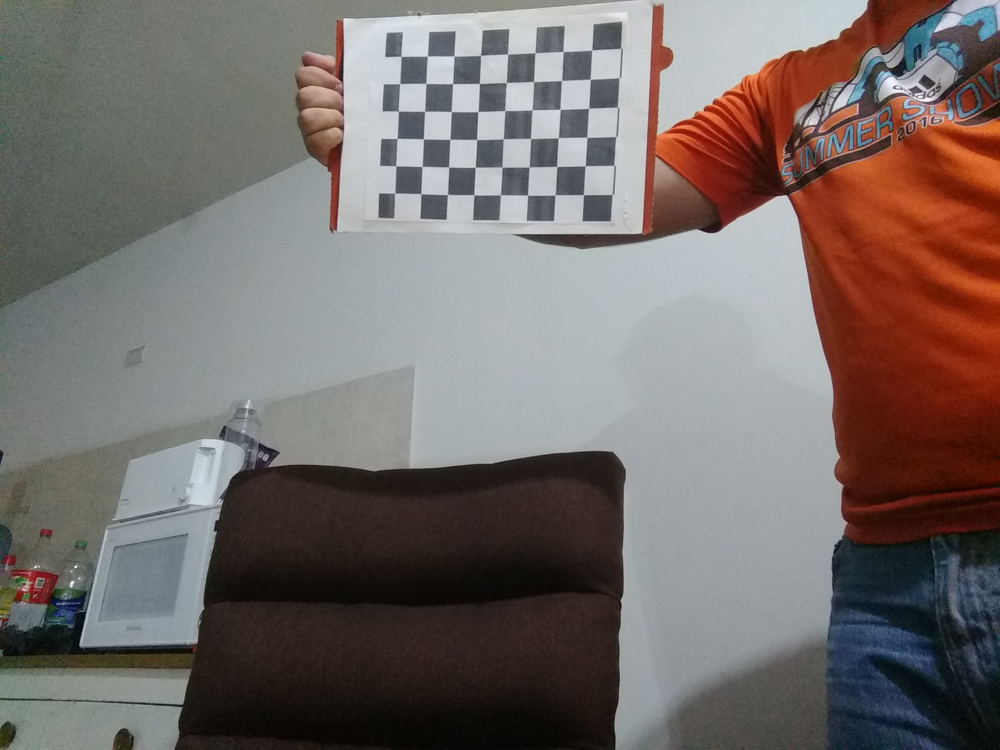

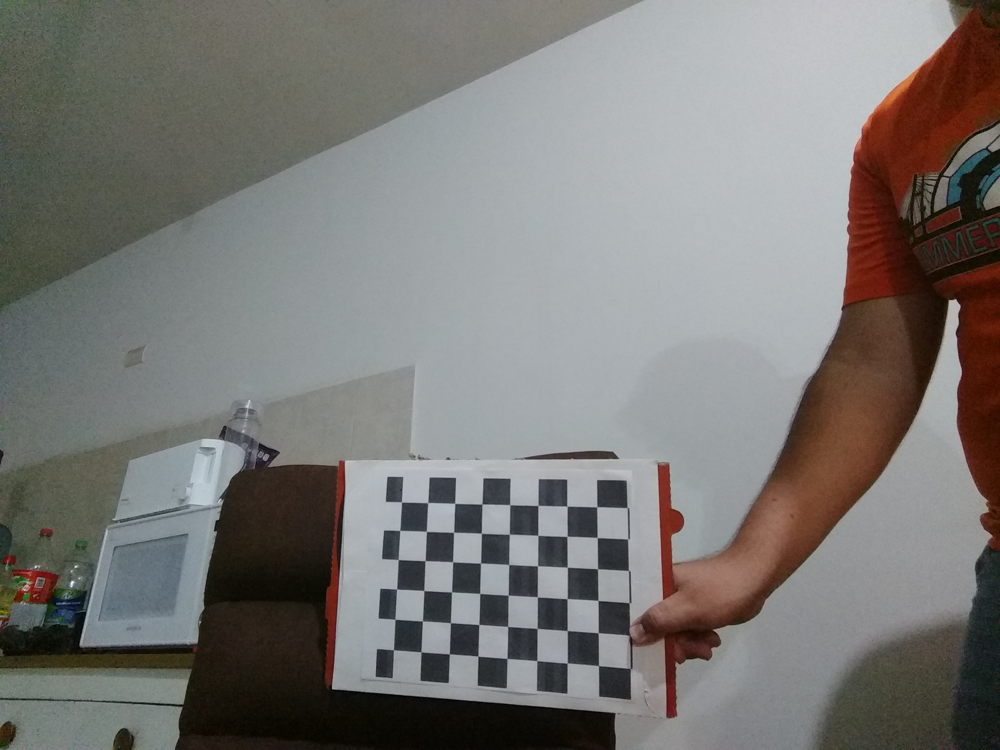

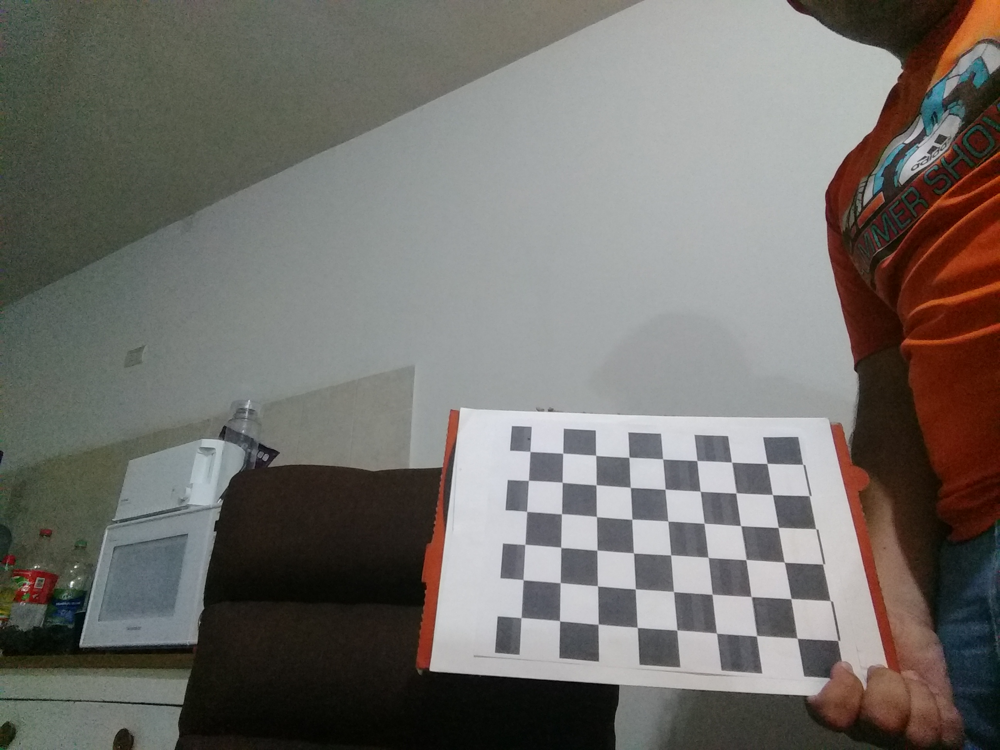

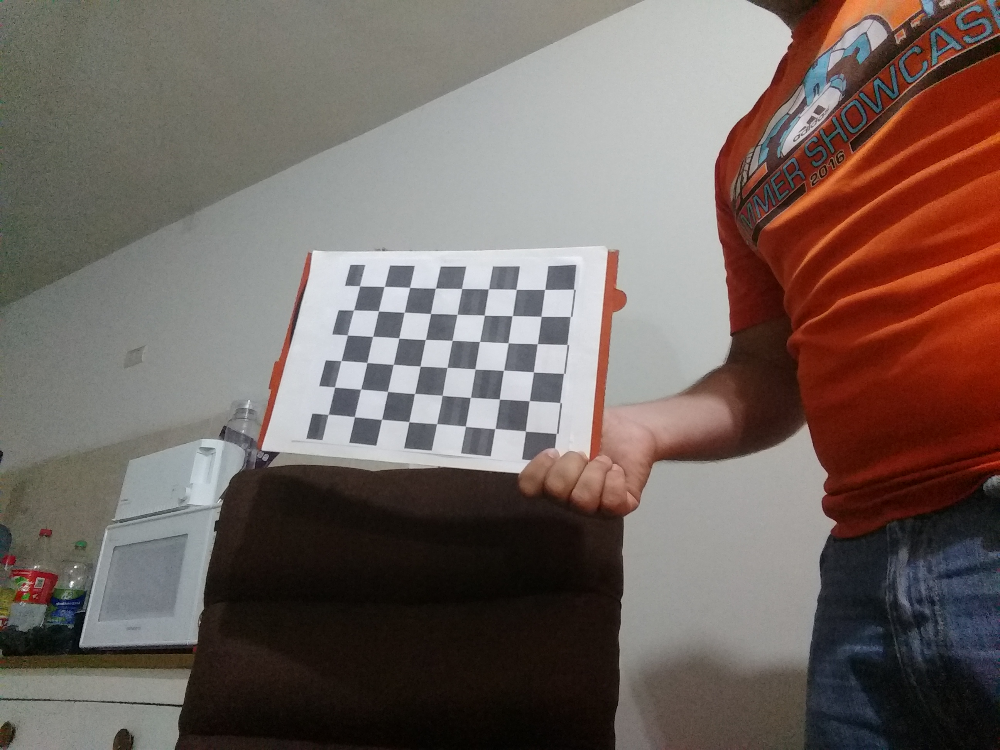

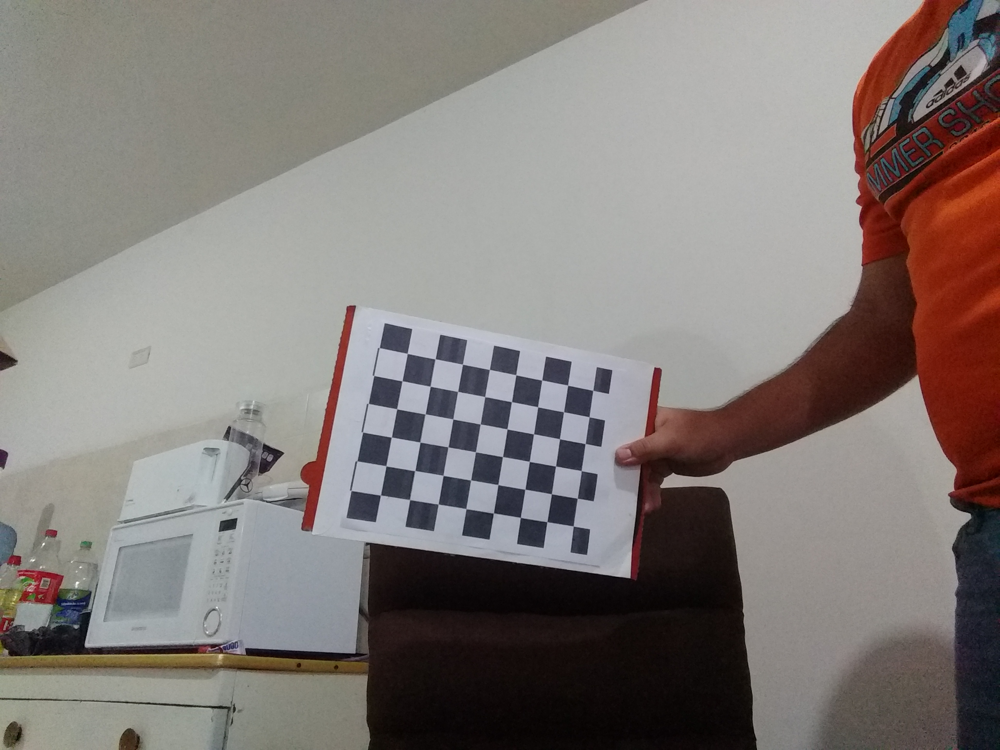

#### Evidencias imagenes utilizando cv2.drawChessboardCorners
Estas son algunas de las imágenes utilizando la instrucción cv2.drawChessboardCorners

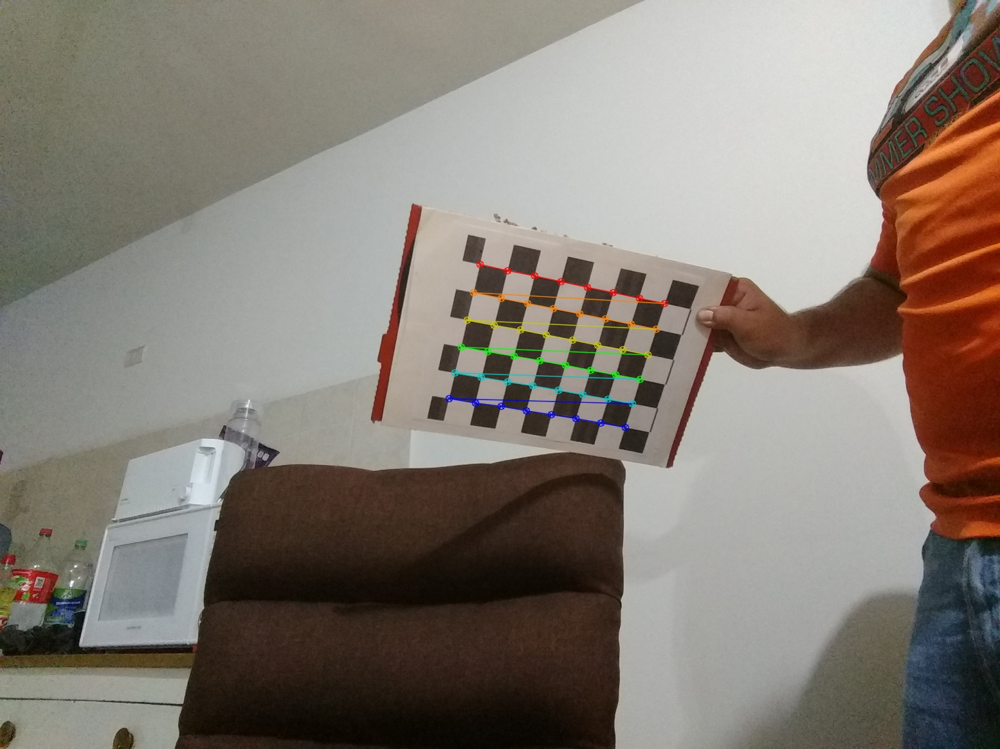

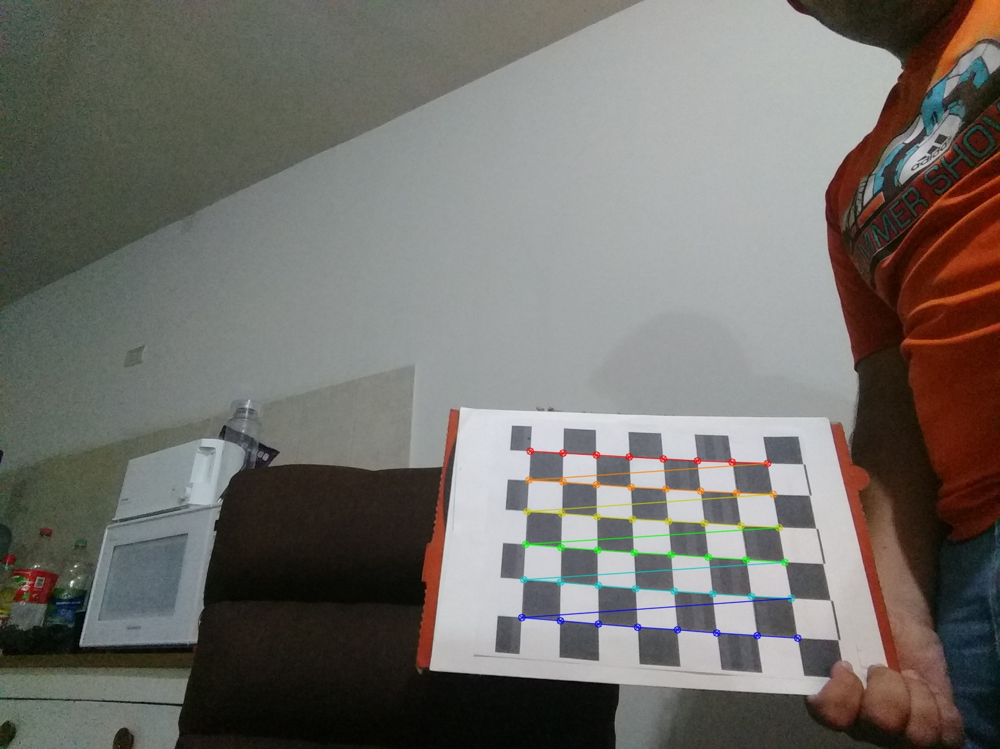

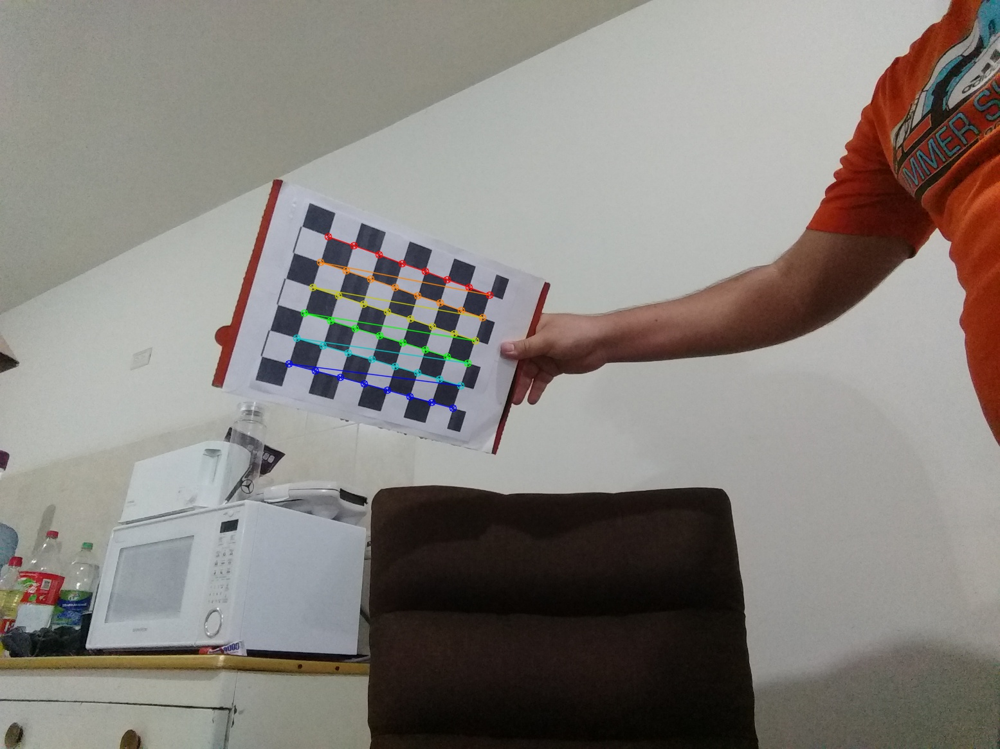

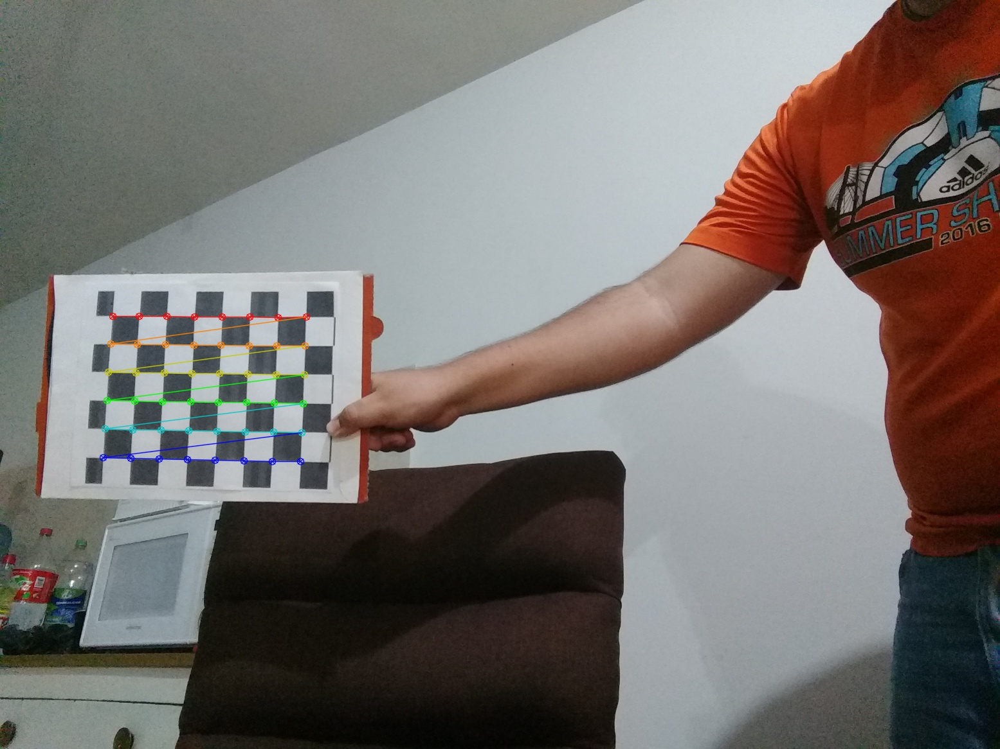

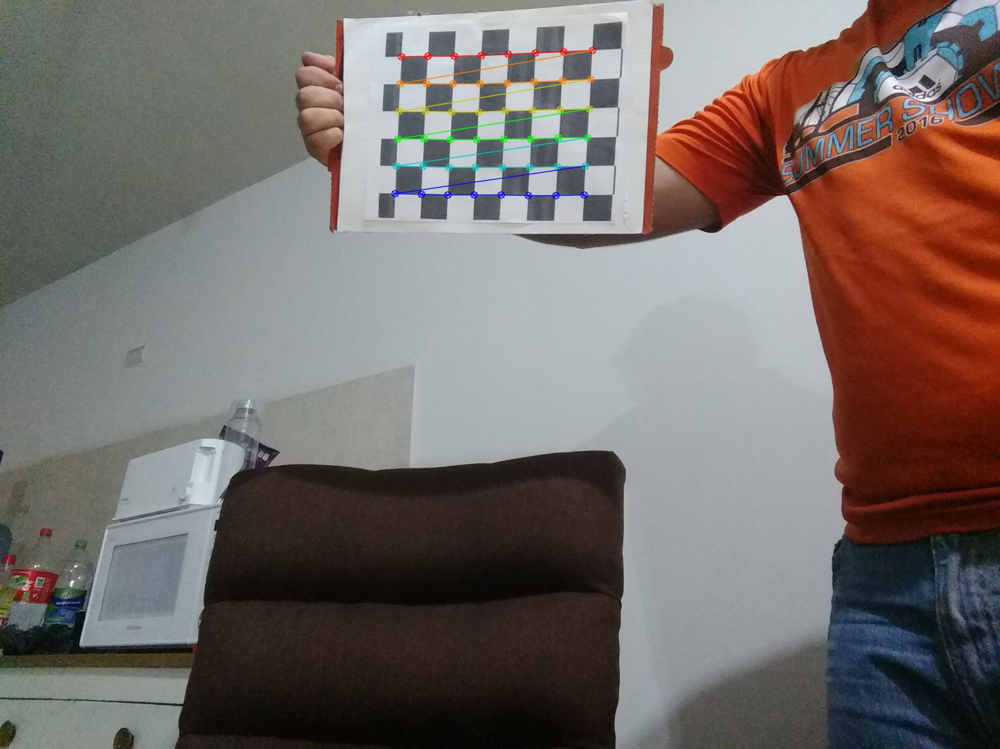

#### Evidencias de imagenes procesadas 
y finalmente estas son algunas imágenes resultantes de la calibración dónde el error total que presenta la cámara es de: 0.1572

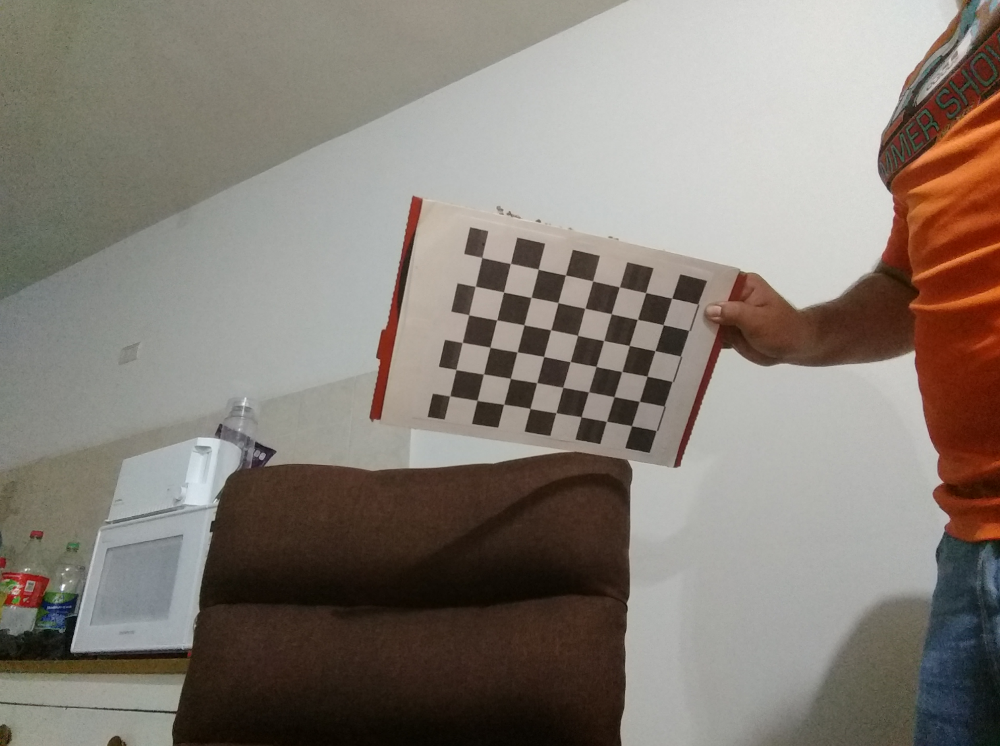

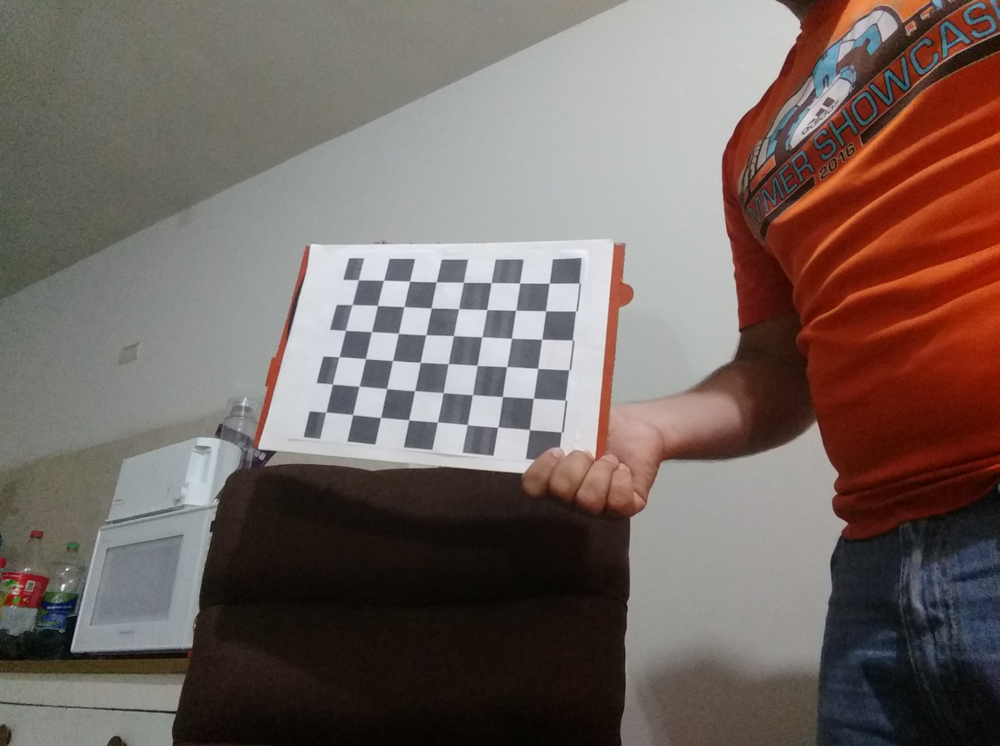

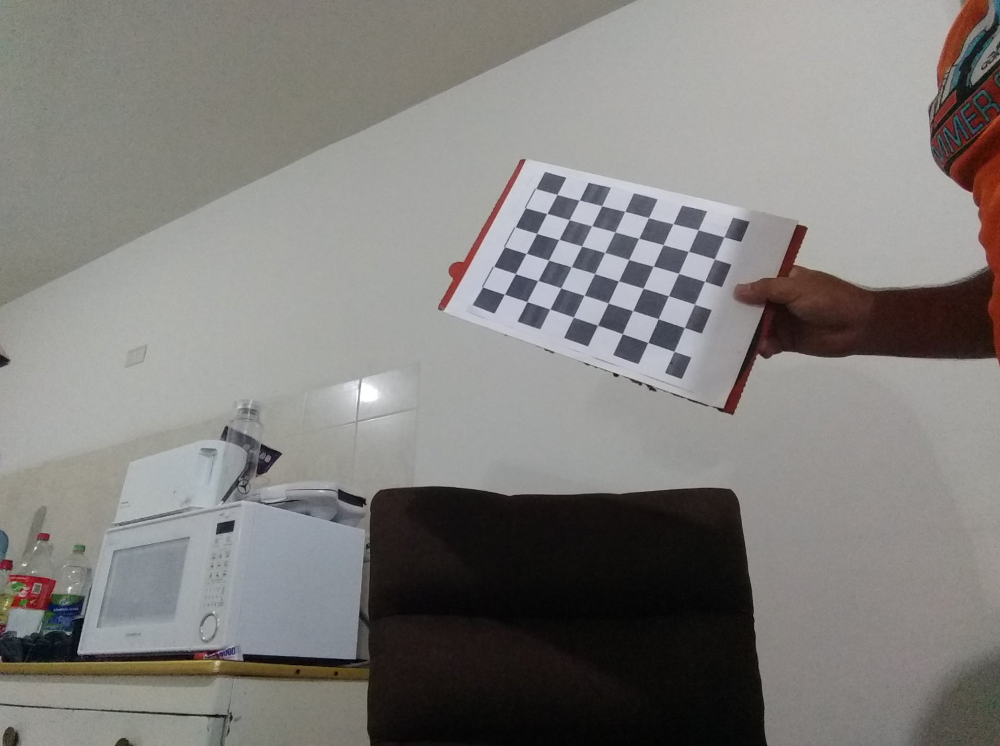

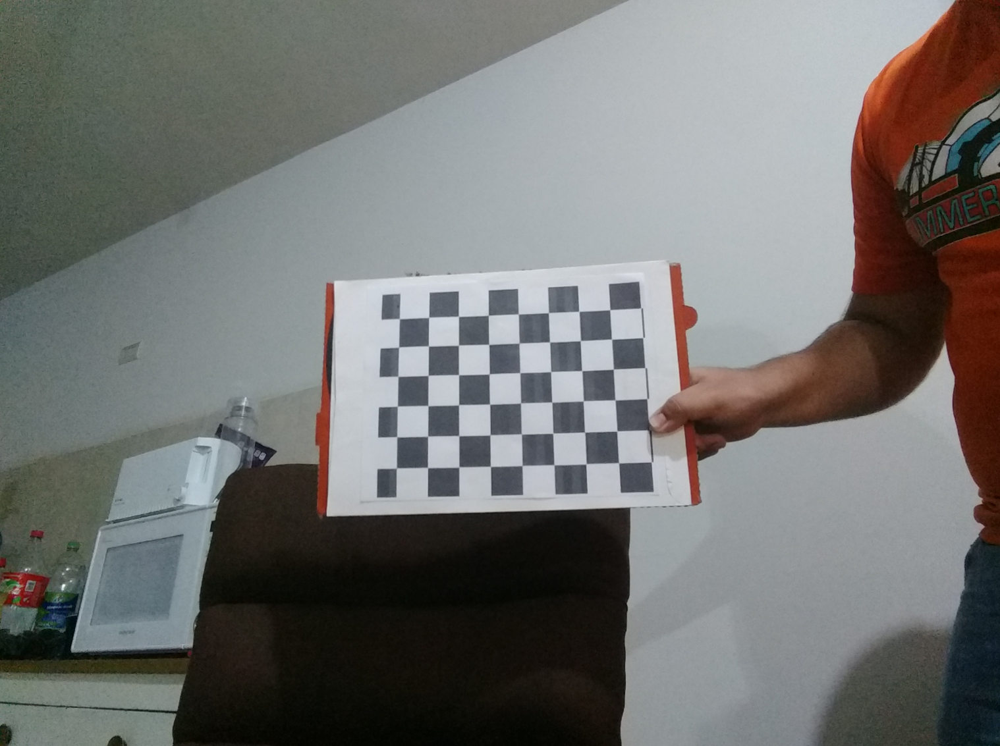

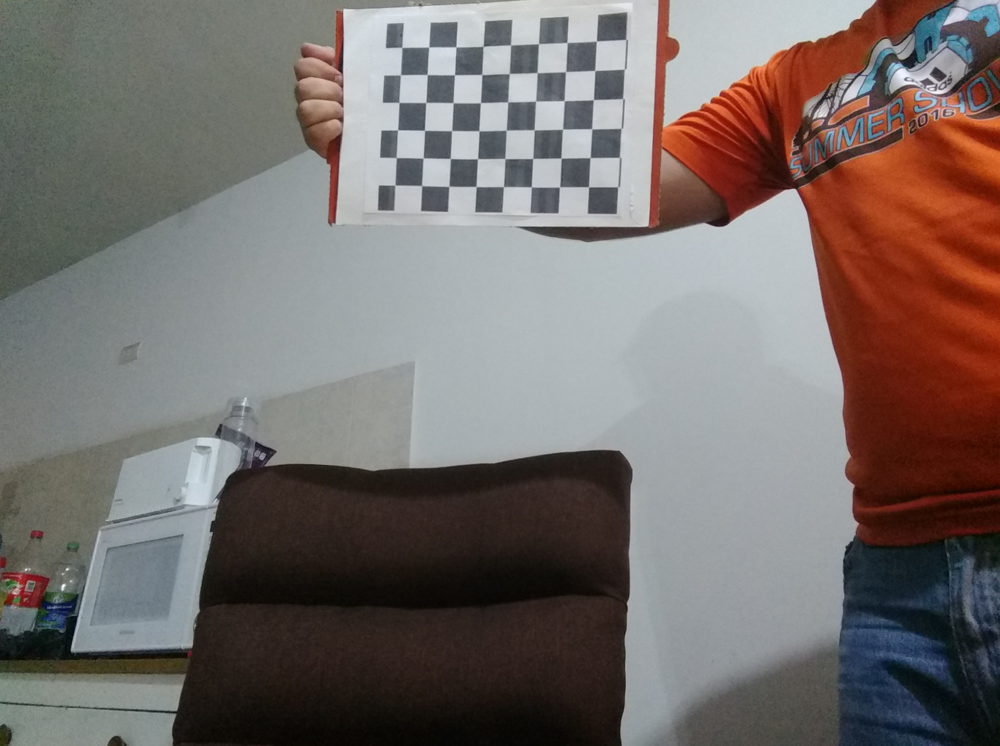

#### Conclusiones
#### Kassandra Dzuara Ibarra Ortiz

Esta práctica me pareció muy buena porque te hace profundizar sobre el conocimiento del campo de visión y el uso de procesamiento computacional de imágenes. Fue retadora porque no tuvimos el soporte de ejemplos como en prácticas anteriores pero creo que esto mismo me llevó a investigar mas del tema y a entender varios aspectos que son necesarios para la calibración de una cámara. Creo que el conocimiento de esta práctica es esencial ya que este tipo de problemas de distorsión de imagen son bastante comunes más que nada porque solemos utilizar cámaras de tipo web que no son tan profesionales por lo que el uso de estos métodos de calibración te permiten sacarle provecho a una herramienta menos costosa a un gran beneficio. 

#### Alberto Jasiel Herrera Michel 


#### Jesus Alejandro Ramirez Castañeda

Gracias a esta práctica nos fue posible lograr corregir el error que nos puede generar el usar una cámara que presenta una distorsión en la imágen, este tema me fue muy recurrente mientras investigaba de otro tipo de temas dentro de este curso pero al leer un poco más del tema no había calibrado la cámara montada en el vehículo, ya que actualmente a menos que la cámara sea de lente amplio es muy raro que estas presenten una distorsión que pudiera afectar el funcionamiento de el proceso que realizamos, y a pesar de esto al hacer esta práctica en con una cámara diferente de laptop aun presenta un error aunque este es pequeño. 